In [1]:
import config
import json, csv, pprint, time, xlsxwriter
import numpy as np
import pandas as pd

from datetime import datetime
from binance.client import Client
from talib import RSI, PLUS_DI, DX, CCI, ADX, MINUS_DI,ATR ,SAR
from binance import BinanceSocketManager
from binance.enums import *
import bb
client = Client(config.API_KEY, config.API_SECRET)
import talib
import os
import math
import mplfinance
import matplotlib as mpf

In [ ]:
tradesm = bb.candlestick_backtest_maxprofit(SYMBOL=config.MATIC,START_DATE='1 week ago UTC',CANDLE_TIMEZONE='3m',RSI_TIMEZONE='15m')

In [ ]:
tradesn = bb.candlestick_backtest(SYMBOL=config.MATIC,START_DATE='1 week ago UTC',CANDLE_TIMEZONE='3m',RSI_TIMEZONE='15m')

In [9]:
tradesm.head()
bb.set_opentime(tradesm)
bb.set_endtime(tradesm)

In [13]:
dates = tradesm[['Open Time','End Time','TP','PNL','PNLQ']].copy()

In [ ]:

onem = client.get_historical_klines("XTZUSDT", Client.KLINE_INTERVAL_1MINUTE, "1 week ago UTC")
ohlc_onem = bb.get_ohlc_his(onem)

fivem = client.get_historical_klines("XTZUSDT", Client.KLINE_INTERVAL_5MINUTE, "1 week ago UTC")
ohlc_fivem = bb.get_ohlc_his(fivem)

threem = client.get_historical_klines("XTZUSDT", Client.KLINE_INTERVAL_3MINUTE, "1 week ago UTC")
ohlc_threem = bb.get_ohlc_his(threem)

fifm = client.get_historical_klines("XTZUSDT",Client.KLINE_INTERVAL_15MINUTE, "1 week ago UTC")
ohlc_fifm = bb.get_ohlc_his(fifm)




In [14]:
d_p = dates.groupby('PNL')
d_p.get_group('Profit').to_csv('max_profit.csv')

In [10]:
trades['PNLQ'].sum()
pnlm = trades.groupby('PNL')
len(trades)


95

In [11]:
tradesn['PNLQ'].sum()
pnl=tradesn.groupby('PNL')
len(tradesn)

95

In [59]:
open_onem = ohlc_onem[0]
high_onem = ohlc_onem[1]
low_onem = ohlc_onem[2]
close_onem = ohlc_onem[3]
#if open[i] == close[i] and close[i]> low[i]:
psar_onem = SAR(high_onem,low_onem)
open_threem = ohlc_threem[0]
high_threem = ohlc_threem[1]
low_threem = ohlc_threem[2]
close_threem = ohlc_threem[3]
#if open[i] == close[i] and close[i]> low[i]:
len(high_threem)




2881

In [14]:
def get_onem_buy_signal(high,close,psar):
    result = []
    for i in range(1,len(open)-1):
    
        if open[i] == high[i] and close[i]> low[i] and psar[i] > close[i]:
        
            result.append(i)
    return result
        
        

In [60]:
df_fifm = pd.DataFrame(fifm, columns=config.FIELD_HISTORICAL)

In [61]:
df_onem = pd.DataFrame(onem, columns=config.FIELD_HISTORICAL)

In [62]:
df_threem = pd.DataFrame(threem, columns=config.FIELD_HISTORICAL)
df_fivem = pd.DataFrame(fivem, columns=config.FIELD_HISTORICAL)
bb.set_date(df_onem)
bb.set_date(df_fifm)
bb.set_date(df_threem)
bb.set_date(df_fivem)
'''df_onem.to_csv('oneminute.csv')
df_threem.to_csv('threeminute.csv')
df_fivem.to_csv('fiveminute.csv')
df_fifm.to_csv('fifminute.csv')'''

"df_onem.to_csv('oneminute.csv')\ndf_threem.to_csv('threeminute.csv')\ndf_fivem.to_csv('fiveminute.csv')\ndf_fifm.to_csv('fifminute.csv')"

In [9]:
df_onemf = df_onem.copy().iloc[:,:7]
df_onemf.head()

,Open Time,Open,High,Low,Close,Volume,Close Time
2021-10-10 09:27:00,1633858020000,7.50500000,7.51100000,7.49400000,7.49400000,15424.50000000,1633858079999
2021-10-10 09:28:00,1633858080000,7.49300000,7.50200000,7.49200000,7.49800000,3156.10000000,1633858139999
2021-10-10 09:29:00,1633858140000,7.50300000,7.52900000,7.50200000,7.51600000,14759.50000000,1633858199999
2021-10-10 09:30:00,1633858200000,7.51500000,7.52200000,7.50000000,7.50900000,7561.40000000,1633858259999
2021-10-10 09:31:00,1633858260000,7.50400000,7.50800000,7.49000000,7.49000000,8983.60000000,1633858319999


In [65]:
len(fifm)

576

In [11]:

df_threemf['Psar'] = psar_threem
df_threemf.dropna(inplace=True)
df_threemf.head(-5)

,Open Time,Open,High,Low,Close,Volume,Close Time,Psar
2021-10-10 09:33:00,1633858380000,7.49200000,7.51000000,7.48800000,7.50200000,9854.70000000,1633858559999,7.484000
2021-10-10 09:36:00,1633858560000,7.50200000,7.50600000,7.46000000,7.48500000,39145.50000000,1633858739999,7.510000
2021-10-10 09:39:00,1633858740000,7.48400000,7.50500000,7.46700000,7.48600000,10242.60000000,1633858919999,7.510000
2021-10-10 09:42:00,1633858920000,7.49100000,7.49900000,7.48400000,7.49200000,7469.40000000,1633859099999,7.509000
2021-10-10 09:45:00,1633859100000,7.48700000,7.50400000,7.48300000,7.49800000,20513.50000000,1633859279999,7.508020
...,...,...,...,...,...,...,...,...
2021-10-17 09:00:00,1634461200000,6.88800000,6.89100000,6.88300000,6.88800000,3016.30000000,1634461379999,6.909733
2021-10-17 09:03:00,1634461380000,6.88700000,6.88800000,6.86500000,6.87300000,15669.70000000,1634461559999,6.909118
2021-10-17 09:06:00,1634461560000,6.87200000,6.87300000,6.86500000,6.86600000,5629.50000000,1634461739999,6.907353
2021-10-17 09:09:00,1634461740000,6.86800000,6.88600000,6.86800000,6.88600000,10093.60000000,1634461919999,6.905659


In [12]:
df_fifmf = df_fifm.copy().iloc[:,:7]
rsi = RSI(df_fifmf['Close'])
df_fifmf['Rsi'] = rsi
df_fifmf.dropna(inplace=True)
df_fifmf.head(-5)

,Open Time,Open,High,Low,Close,Volume,Close Time,Rsi
2021-10-10 13:00:00,1633870800000,7.39900000,7.42000000,7.36400000,7.40400000,138345.70000000,1633871699999,37.209302
2021-10-10 13:15:00,1633871700000,7.40100000,7.44600000,7.38300000,7.40700000,87091.60000000,1633872599999,37.793531
2021-10-10 13:30:00,1633872600000,7.40700000,7.43200000,7.38900000,7.39300000,72854.10000000,1633873499999,36.105232
2021-10-10 13:45:00,1633873500000,7.39400000,7.40800000,7.37500000,7.38000000,48256.40000000,1633874399999,34.561321
2021-10-10 14:00:00,1633874400000,7.38000000,7.42500000,7.37300000,7.42300000,52730.80000000,1633875299999,43.211451
...,...,...,...,...,...,...,...,...
2021-10-17 07:00:00,1634454000000,6.89100000,6.90800000,6.88900000,6.90500000,16855.40000000,1634454899999,50.301204
2021-10-17 07:15:00,1634454900000,6.90700000,6.92500000,6.88900000,6.89500000,52188.30000000,1634455799999,47.162271
2021-10-17 07:30:00,1634455800000,6.89500000,6.90700000,6.87400000,6.88600000,40461.20000000,1634456699999,44.472459
2021-10-17 07:45:00,1634456700000,6.88600000,6.88800000,6.84900000,6.84900000,50751.60000000,1634457599999,35.506792


In [13]:
df_fivemf = df_fivem.copy().iloc[:,:7]
rsif = RSI(df_fivem['Close'])
df_fivemf['Rsi'] = rsi
df_fivemf.dropna(inplace=True)

In [ ]:
permisson = False
res = []
trades = pd.DataFrame()
df_threem['Psar'] = df_threem['Psar'].astype(str)
for index, row in df_fifmf.iterrows():
    if not trades.empty:
        trades_status = trades.groupby(['Status'])
    #trades_status.get_group('Close')
    if row['Rsi'] > 50 : 
        permisson  = True
        time = row['Close Time']+1
        search_df = df_onemf.loc[(df_onemf['Open Time' ] >= time ) & (df_onemf['Open Time'] <= time+280000)]
        positions = search_df[(search_df['Open'] == search_df['High']) & (search_df['Close'] > search_df['Low'] ) & (search_df['Psar'] > search_df['Close'] )]
        positions.insert(8,'Status', 'Open')
        positions.insert(9,'Margin', 100)
        positions.insert(10,'End Time', '')
        positions['Close Price'] = np.nan
        positions['Ratio'] = np.nan
        positions.insert(13,'PNL', '')
        positions['PNLQ'] = np.nan
        positions
        trades = trades.append(positions)
        
        
        if not trades.empty:
            trades_status = trades.groupby(['Status'])
            try:
                if not trades_status.get_group('Open').empty:
                    for ind, ro in trades_status.get_group('Open').iterrows():
                        match_df = search_df.loc[(search_df['Open Time'] > ro['Open Time'])]
                        for i,r in match_df.iterrows():
                            if ro['Psar'] <= r['High']:
                                trades.at[ind,'End Time'] = r['Open Time']
                                trades.at[ind,'Close Price'] = ro['Psar']
                                trades.at[ind,'Ratio'] = float(ro['Psar'])/float(ro['Close'])
                                trades.at[ind,'PNL'] = 'Profit'
                                trades.at[ind,'PNLQ'] = ((float(ro['Psar'])/float(ro['Close']))*100) - 100
                                trades.at[ind,'Status'] = 'Close'
                                break
                        '''
                        ro['End Time'] = r['Open Time']
                        ro['Close Price'] = ro['Psar']
                        ro['Ratio'] = float(ro['Psar'])/float(ro['Close'])
                        ro['PNL'] = 'Profit'
                        ro['PNLQ'] = ((float(ro['Psar'])/float(ro['Close']))*100) - 100
                        ro['Status'] = 'Close'
                        '''
            except:
                print('All Position is closed')
                        
                       
    
    else:
        permission = False
        if not trades.empty:
            trades_status = trades.groupby(['Status'])
            try:
                if not trades_status.get_group('Open').empty:
                    for i, r in trades_status.get_group('Open').iterrows():

                        trades.at[i,'End Time'] = row['Close Time']
                        trades.at[i,'Close Price'] =  row['Close']
                        trades.at[i,'Ratio'] = float(row['Close'])/float(r['Close'])
                        trades.at[i,'PNL'] = 'Profit'
                        trades.at[i,'PNLQ'] = ((float(row['Close'])/float(r['Close']))*100) - 100
                        trades.at[i,'Status'] = 'Close'

                        '''
                        r['End Time'] = row['Close Time']
                        r['Ratio'] = float(row['Close'])/float(r['Close'])
                        r['Close Price'] = row['Close']
                        r['Status'] = 'Close'
                        r['PNLQ'] = ((float(row['Close'])/float(r['Close']))*100) - 100
                        '''
                        if row['Close'] > r['Close']:
                             trades.at[i,'PNL'] = 'Profit'
                        else:
                            trades.at[i,'PNL'] = 'Loss'
    
    
            except:
                print('All Position is Closed')
                        
                    
                    
        

In [16]:
len(trades)

9

In [35]:
d = 1634076000000 
search_df = df_onemf.loc[(df_onemf['Open Time' ] >= d ) & (df_onemf['Open Time'] <= d+840000)]

In [36]:
'''signals_psar = []
for i in result:
    signals_psar.append(round(float(psar[i]),3))'''

'signals_psar = []\nfor i in result:\n    signals_psar.append(round(float(psar[i]),3))'

In [37]:
type(df_onemf['Psar'].iloc[0])

str

In [23]:

df_onemf['Low'] = df_onemf['Low'].astype(float)

In [17]:
'''z = 0
for index,psar in df_test.iloc[:].values:
    i = int(index) + 1
    
    for ind,high in td.iloc[i:,:].values:
        if float(high) >= float(psar):
            z = z + 1
            print(td['index'][index])
            print(ind)
            print("-----")
           
            
            
            break'''
    

'z = 0\nfor index,psar in df_test.iloc[:].values:\n    i = int(index) + 1\n    \n    for ind,high in td.iloc[i:,:].values:\n        if float(high) >= float(psar):\n            z = z + 1\n            print(td[\'index\'][index])\n            print(ind)\n            print("-----")\n           \n            \n            \n            break'

In [15]:
status = trades.groupby('Status')
closed_trades  = status.get_group('Close')


In [16]:
pnl_grp = closed_trades.groupby('PNL')


In [17]:
hasılat = closed_trades['PNLQ'].sum()

In [18]:
hasılat

-1.5879802208873457

In [19]:
len(closed_trades)

44

In [17]:
pnl_grp.get_group('Loss').to_csv('Loss_Matic_1month.csv')

In [18]:
pnl_grp.get_group('Profit').to_csv('Profit_Matic_1month.csv')

In [20]:


tradesf = closed_trades.copy()

In [21]:
date = tradesf['Open Time']
final_date = []
for time in date:
    time = time/1000
    readable = datetime.utcfromtimestamp(time)
    final_date.append(readable) 
tradesf['Open Time'] = final_date
    

In [22]:
times = tradesf['End Time']
final_times = []
for d in times:
    d = d/1000
    readable = datetime.utcfromtimestamp(d)
    final_times.append(readable) 
tradesf['End Time'] = final_times

In [40]:
tradesf[['Open Time','End Time','Close','Close Price','Ratio']].to_csv('trades_matic_1da.csv')

In [24]:
trades[['Open Time','End Time','Close','Close Price','Ratio']].to_csv('trades_matic_.csv')

In [114]:
tradesf

''

In [37]:
df_oneplot = df_onemf.copy()
df_fiveplot = df_fivem.copy()

In [38]:
df_oneplot['Volume'] = df_oneplot['Volume'].astype(float)
df_oneplot['High'] = df_oneplot['High'].astype(float)
df_oneplot['Low'] = df_oneplot['Low'].astype(float)
df_oneplot['Open'] = df_oneplot['Open'].astype(float)
df_oneplot['Close'] = df_oneplot['Close'].astype(float)
df_fiveplot['Volume'] = df_fiveplot['Volume'].astype(float)
df_fiveplot['High'] = df_fiveplot['High'].astype(float)
df_fiveplot['Low'] = df_fiveplot['Low'].astype(float)
df_fiveplot['Open'] = df_fiveplot['Open'].astype(float)
df_fiveplot['Close'] = df_fiveplot['Close'].astype(float)

In [47]:
%matplotlib notebook


In [40]:
df_fiveplot.to_csv('five.csv')

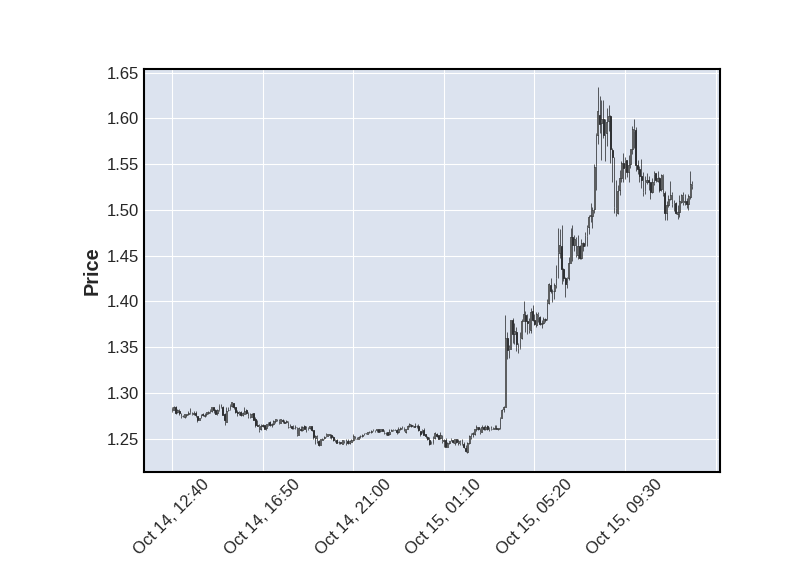

In [48]:
mplfinance.plot(df_fiveplot,type='candle')

In [62]:
%matplotlib inline

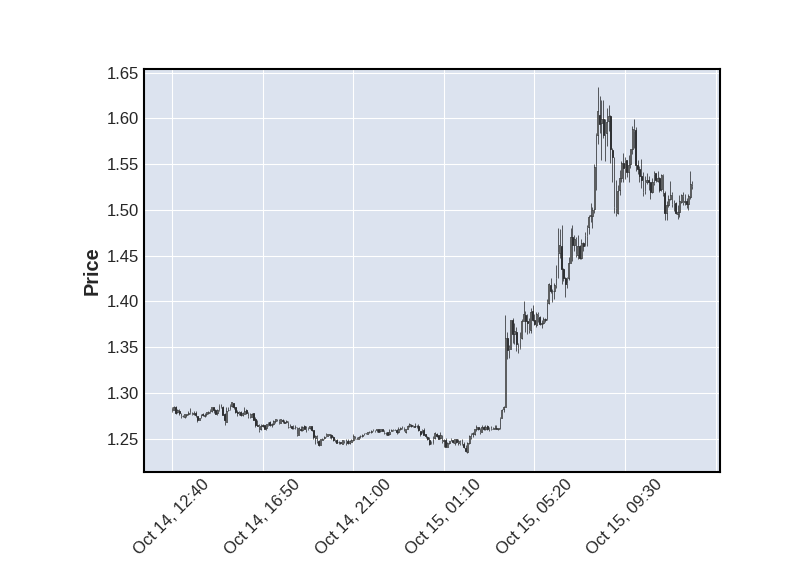

In [50]:
mplfinance.plot(df_fiveplot,type='candle')

In [55]:

matplotlib.pyplot.switch_backend()

ModuleNotFoundError: No module named 'matplotlib.backends.backend_notebook'

In [57]:
f = pd.read_csv('five.csv')

In [66]:
fig = mpf.figure(figsize=(20,10)) 
ax1 = fig.add_subplot(2,1,1) 
ax2 = fig.add_subplot(2,1,2)



TypeError: 'module' object is not callable

In [14]:
permisson = False
res = []
trades = pd.DataFrame()
df_threemf['Psar'] = df_threemf['Psar'].astype(str)
for index, row in df_fifmf.iterrows():
    if not trades.empty:
        trades_status = trades.groupby(['Status'])
    #trades_status.get_group('Close')
    if row['Rsi'] > 50 : 
        permisson  = True
        time = row['Close Time']+1
        search_df = df_threemf.loc[(df_threemf['Open Time' ] >= time ) & (df_threemf['Open Time'] <= time+840000)]
        positions = search_df[(search_df['Open'] == search_df['High']) & (search_df['Close'] > search_df['Low'] ) & (search_df['Psar'] > search_df['Close'] )]
        positions.insert(8,'Status', 'Open')
        positions.insert(9,'Margin', 100)
        positions.insert(10,'End Time', '')
        positions['Close Price'] = np.nan
        positions['Ratio'] = np.nan
        positions.insert(13,'PNL', '')
        positions['PNLQ'] = np.nan
        positions
        trades = trades.append(positions)
        
        
        if not trades.empty:
            trades_status = trades.groupby(['Status'])
            try:
                if not trades_status.get_group('Open').empty:
                    for ind, ro in trades_status.get_group('Open').iterrows():
                        match_df = search_df.loc[(search_df['Open Time'] > ro['Open Time'])]
                        for i,r in match_df.iterrows():
                            if ro['Psar'] <= r['High']:
                                trades.at[ind,'End Time'] = r['Open Time']
                                trades.at[ind,'Close Price'] = ro['Psar']
                                trades.at[ind,'Ratio'] = float(ro['Psar'])/float(ro['Close'])
                                trades.at[ind,'PNL'] = 'Profit'
                                trades.at[ind,'PNLQ'] = ((float(ro['Psar'])/float(ro['Close']))*100) - 100
                                trades.at[ind,'Status'] = 'Close'
                                break
                        '''
                        ro['End Time'] = r['Open Time']
                        ro['Close Price'] = ro['Psar']
                        ro['Ratio'] = float(ro['Psar'])/float(ro['Close'])
                        ro['PNL'] = 'Profit'
                        ro['PNLQ'] = ((float(ro['Psar'])/float(ro['Close']))*100) - 100
                        ro['Status'] = 'Close'
                        '''
            except:
                print('All Position is closed')
                        
                       
    
    else:
        permission = False
        if not trades.empty:
            trades_status = trades.groupby(['Status'])
            try:
                if not trades_status.get_group('Open').empty:
                    for i, r in trades_status.get_group('Open').iterrows():

                        trades.at[i,'End Time'] = row['Close Time']
                        trades.at[i,'Close Price'] =  row['Close']
                        trades.at[i,'Ratio'] = float(row['Close'])/float(r['Close'])
                        trades.at[i,'PNL'] = 'Profit'
                        trades.at[i,'PNLQ'] = ((float(row['Close'])/float(r['Close']))*100) - 100
                        trades.at[i,'Status'] = 'Close'

                        '''
                        r['End Time'] = row['Close Time']
                        r['Ratio'] = float(row['Close'])/float(r['Close'])
                        r['Close Price'] = row['Close']
                        r['Status'] = 'Close'
                        r['PNLQ'] = ((float(row['Close'])/float(r['Close']))*100) - 100
                        '''
                        if row['Close'] > r['Close']:
                             trades.at[i,'PNL'] = 'Profit'
                        else:
                            trades.at[i,'PNL'] = 'Loss'
    
    
            except:
                print('All Position is Closed')
                        
                    
                    
                

<ipython-input-14-e5b3e7f80147>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
<ipython-input-14-e5b3e7f80147>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
<ipython-input-14-e5b3e7f80147>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexin

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

<ipython-input-14-e5b3e7f80147>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
<ipython-input-14-e5b3e7f80147>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
<ipython-input-14-e5b3e7f80147>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexin

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


<ipython-input-14-e5b3e7f80147>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
<ipython-input-14-e5b3e7f80147>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
<ipython-input-14-e5b3e7f80147>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexin

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


<ipython-input-14-e5b3e7f80147>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
<ipython-input-14-e5b3e7f80147>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
<ipython-input-14-e5b3e7f80147>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexin

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


<ipython-input-14-e5b3e7f80147>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
<ipython-input-14-e5b3e7f80147>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
<ipython-input-14-e5b3e7f80147>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexin

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

<ipython-input-14-e5b3e7f80147>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
<ipython-input-14-e5b3e7f80147>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
<ipython-input-14-e5b3e7f80147>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexin

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


<ipython-input-14-e5b3e7f80147>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
<ipython-input-14-e5b3e7f80147>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
<ipython-input-14-e5b3e7f80147>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexin

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


<ipython-input-14-e5b3e7f80147>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
<ipython-input-14-e5b3e7f80147>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
<ipython-input-14-e5b3e7f80147>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexin

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

<ipython-input-14-e5b3e7f80147>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
<ipython-input-14-e5b3e7f80147>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
<ipython-input-14-e5b3e7f80147>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexin

All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


<ipython-input-14-e5b3e7f80147>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
<ipython-input-14-e5b3e7f80147>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
<ipython-input-14-e5b3e7f80147>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexin

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


<ipython-input-14-e5b3e7f80147>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
<ipython-input-14-e5b3e7f80147>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
<ipython-input-14-e5b3e7f80147>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexin

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

<ipython-input-14-e5b3e7f80147>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
<ipython-input-14-e5b3e7f80147>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
<ipython-input-14-e5b3e7f80147>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexin

In [66]:
def candlestick_backtest(SYMBOL='',CANDLE_TIMEZONE='',RSI_TIMEZONE='',START_DATE='',END_DATE='',):
    interval = {
        '1m' : Client.KLINE_INTERVAL_1MINUTE ,
        '3m' : Client.KLINE_INTERVAL_3MINUTE ,
        '5m' : Client.KLINE_INTERVAL_5MINUTE ,
        '15m': Client.KLINE_INTERVAL_15MINUTE ,
        '30m': Client.KLINE_INTERVAL_30MINUTE,
        '1h': Client.KLINE_INTERVAL_1HOUR,
        '4h': Client.KLINE_INTERVAL_4HOUR,
        '1d': Client.KLINE_INTERVAL_1DAY,
        '1w': Client.KLINE_INTERVAL_1WEEK,
    }
    SEARCH_RATE=840000
    if RSI_TIMEZONE == '15m' and CANDLE_TIMEZONE =='1m':
        SEARCH_RATE = 840000
    if RSI_TIMEZONE == '15m' and CANDLE_TIMEZONE =='3m':
        SEARCH_RATE = 840000
    if RSI_TIMEZONE == '5m' and CANDLE_TIMEZONE =='1m':
        SEARCH_RATE = 240000
    if RSI_TIMEZONE == '5m' and CANDLE_TIMEZONE =='3m':
        SEARCH_RATE = 240000
    if END_DATE == '':
        candle_data = client.get_historical_klines(SYMBOL, interval[CANDLE_TIMEZONE],START_DATE)
        rsi_data = client.get_historical_klines(SYMBOL, interval[RSI_TIMEZONE],START_DATE)
    else:
        candle_data = client.get_historical_klines(SYMBOL, interval[CANDLE_TIMEZONE],START_DATE,END_DATE)
        rsi_data = client.get_historical_klines(SYMBOL, interval[RSI_TIMEZONE],START_DATE,END_DATE)
    
    
        
    
    df_candle = pd.DataFrame(candle_data, columns=config.FIELD_HISTORICAL)
    df_rsi = pd.DataFrame(rsi_data, columns=config.FIELD_HISTORICAL)
    bb.set_date(df_candle)
    bb.set_date(df_rsi)
    df_candle = df_candle.copy().iloc[:,:7]
    df_rsi = df_rsi.copy().iloc[:,:7]
    
    psar_candle = SAR(df_candle['High'],df_candle['Low'])
    rsi = RSI(df_rsi['Close'])
    
    
    df_candle['PSAR'] = psar_candle
    df_candle.dropna(inplace=True)
    
    df_rsi['RSI'] = rsi
    df_rsi.dropna(inplace=True)
    
    permisson = False
    res = []
    trades = pd.DataFrame()
    df_candle['PSAR'] = df_candle['PSAR'].astype(str)
    for index, row in df_rsi.iterrows():
        
        if not trades.empty:
            trades_status = trades.groupby(['Status'])
        #trades_status.get_group('Close')
        if row['RSI'] > 50 : 
            permisson  = True
            time = row['Close Time']+1
            search_df = df_candle.loc[(df_candle['Open Time' ] >= time ) & (df_candle['Open Time'] <= time+SEARCH_RATE)]
            positions = search_df[(search_df['Open'] == search_df['High']) & (search_df['Close'] > search_df['Low'] ) & (search_df['PSAR'] > search_df['Close'] )]
            positions.insert(8,'Status', 'Open')
            positions.insert(9,'Margin', 100)
            positions.insert(10,'End Time', '')
            positions['Close Price'] = np.nan
            positions['Ratio'] = np.nan
            positions.insert(13,'PNL', '')
            positions['PNLQ'] = np.nan
            positions
            trades = trades.append(positions)


            if not trades.empty:
                trades_status = trades.groupby(['Status'])
                try:
                    if not trades_status.get_group('Open').empty:
                        for ind, ro in trades_status.get_group('Open').iterrows():
                            match_df = search_df.loc[(search_df['Open Time'] > ro['Open Time'])]
                            for i,r in match_df.iterrows():
                                if ro['PSAR'] <= r['High']:
                                    trades.at[ind,'End Time'] = r['Open Time']
                                    trades.at[ind,'Close Price'] = ro['PSAR']
                                    trades.at[ind,'Ratio'] = float(ro['PSAR'])/float(ro['Close'])
                                    trades.at[ind,'PNL'] = 'Profit'
                                    trades.at[ind,'PNLQ'] = ((float(ro['PSAR'])/float(ro['Close']))*100) - 100
                                    trades.at[ind,'Status'] = 'Close'
                                    break
                            '''
                            ro['End Time'] = r['Open Time']
                            ro['Close Price'] = ro['Psar']
                            ro['Ratio'] = float(ro['Psar'])/float(ro['Close'])
                            ro['PNL'] = 'Profit'
                            ro['PNLQ'] = ((float(ro['Psar'])/float(ro['Close']))*100) - 100
                            ro['Status'] = 'Close'
                            '''
                except:
                    print('All Position is closed')



        else:
            permission = False
            if not trades.empty:
                trades_status = trades.groupby(['Status'])
                try:
                    if not trades_status.get_group('Open').empty:
                        for i, r in trades_status.get_group('Open').iterrows():

                            trades.at[i,'End Time'] = row['Close Time']
                            trades.at[i,'Close Price'] =  row['Close']
                            trades.at[i,'Ratio'] = float(row['Close'])/float(r['Close'])
                            trades.at[i,'PNL'] = 'Profit'
                            trades.at[i,'PNLQ'] = ((float(row['Close'])/float(r['Close']))*100) - 100
                            trades.at[i,'Status'] = 'Close'

                            '''
                            r['End Time'] = row['Close Time']
                            r['Ratio'] = float(row['Close'])/float(r['Close'])
                            r['Close Price'] = row['Close']
                            r['Status'] = 'Close'
                            r['PNLQ'] = ((float(row['Close'])/float(r['Close']))*100) - 100
                            '''
                            if row['Close'] > r['Close']:
                                 trades.at[i,'PNL'] = 'Profit'
                            else:
                                trades.at[i,'PNL'] = 'Loss'


                except:
                    print('All Position is Closed')

                    
    
    
    df = trades.groupby('Status')
    
    return df.get_group('Close')

    
    

In [3]:
len(config.ARRAY)

112

In [15]:
sum = 0 ;
for coin in config.ARRAY : 
    trades = bb.candlestick_backtest_maxprofit(SYMBOL=coin,START_DATE='1 week ago UTC',CANDLE_TIMEZONE='3m',RSI_TIMEZONE='15m')
    sum = sum + float(trades['PNLQ'].sum())
    
    

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc


All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value


All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa


All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc


All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positi

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc


All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc


All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positi

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc


All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py


All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Positi

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc


All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc


All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value


All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value


All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc


All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py


All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/


All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py


All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc


All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/


All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc


All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value


All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/


All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc


All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa


All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value


All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value


All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['TP']   = positions['PSAR'].copy()
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.py

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['PNLQ'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:834: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stabl

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value


All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value
/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value


All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:846: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  open_positions['TP'] = profit_value


All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:830: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:831: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:833: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


BinanceAPIException: APIError(code=-1121): Invalid symbol.

In [68]:
sum

555.6648008670724

In [68]:
sum

555.6648008670724

In [13]:
sum


512.4084788405758

In [16]:
sum

291.5721532395434

In [15]:

trades = bb.candlestick_backtest(SYMBOL=config.MATIC,START_DATE='1 week ago UTC',CANDLE_TIMEZONE='3m',RSI_TIMEZONE='15m')

/home/kali/Desktop/Folder/project/bb.py:687: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:688: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:690: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:687: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:688: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:690: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:687: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:688: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:690: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:687: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:688: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:690: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:687: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:688: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:690: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:687: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:688: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:690: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:687: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:688: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:690: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:687: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:688: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:690: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:687: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:688: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:690: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:687: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:688: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:690: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed


/home/kali/Desktop/Folder/project/bb.py:687: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:688: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:690: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:687: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:688: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:690: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is Closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Positio

/home/kali/Desktop/Folder/project/bb.py:687: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:688: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:690: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is closed
All Position is closed
All Position is closed
All Position is Closed
All Position is Closed
All Position is Closed
All Position is Closed


/home/kali/Desktop/Folder/project/bb.py:687: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Close Price'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:688: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions['Ratio'] = np.nan
/home/kali/Desktop/Folder/project/bb.py:690: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-doc

In [16]:
trades.head()

,Open Time,Open,High,Low,Close,Volume,Close Time,PSAR,Status,Margin,End Time,Close Price,Ratio,PNL,PNLQ
2021-10-12 19:54:00,1634068440000,1.21300000,1.21300000,1.20600000,1.20800000,238608.00000000,1634068619999,1.2242096,Close,100,1634076000000,1.224210,1.013419,Profit,1.341854
2021-10-12 20:06:00,1634069160000,1.21100000,1.21100000,1.19400000,1.20300000,1041595.90000000,1634069339999,1.220217126262016,Close,100,1634071140000,1.220217,1.014312,Profit,1.431183
2021-10-12 23:48:00,1634082480000,1.22300000,1.22300000,1.22100000,1.22300000,95249.20000000,1634082659999,1.2301929341720503,Close,100,1634083740000,1.230193,1.005881,Profit,0.588139
2021-10-13 01:27:00,1634088420000,1.25500000,1.25500000,1.25200000,1.25300000,72524.00000000,1634088599999,1.26188754176,Close,100,1634100299999,1.239000,0.988827,Loss,-1.117318
2021-10-13 01:33:00,1634088780000,1.25100000,1.25100000,1.24900000,1.25100000,44208.80000000,1634088959999,1.260390746114048,Close,100,1634100299999,1.239000,0.990408,Loss,-0.959233


In [17]:
trades['PNL']= 'Hello'

In [18]:
trades.head()

,Open Time,Open,High,Low,Close,Volume,Close Time,PSAR,Status,Margin,End Time,Close Price,Ratio,PNL,PNLQ
2021-10-12 19:54:00,1634068440000,1.21300000,1.21300000,1.20600000,1.20800000,238608.00000000,1634068619999,1.2242096,Close,100,1634076000000,1.224210,1.013419,Hello,1.341854
2021-10-12 20:06:00,1634069160000,1.21100000,1.21100000,1.19400000,1.20300000,1041595.90000000,1634069339999,1.220217126262016,Close,100,1634071140000,1.220217,1.014312,Hello,1.431183
2021-10-12 23:48:00,1634082480000,1.22300000,1.22300000,1.22100000,1.22300000,95249.20000000,1634082659999,1.2301929341720503,Close,100,1634083740000,1.230193,1.005881,Hello,0.588139
2021-10-13 01:27:00,1634088420000,1.25500000,1.25500000,1.25200000,1.25300000,72524.00000000,1634088599999,1.26188754176,Close,100,1634100299999,1.239000,0.988827,Hello,-1.117318
2021-10-13 01:33:00,1634088780000,1.25100000,1.25100000,1.24900000,1.25100000,44208.80000000,1634088959999,1.260390746114048,Close,100,1634100299999,1.239000,0.990408,Hello,-0.959233
